In [34]:
import os
from glob import glob
from tqdm import tqdm
from pathlib import Path
import version_information

import numpy as np
import pandas as pd
from scipy import integrate
import matplotlib.pyplot as plt
from matplotlib.patches import Circle

import astropy.units as u
import astropy.constants as const
from astropy.io import fits
from astropy.table import Table
from astropy import coordinates as coords
from astropy.coordinates import Angle

import re
import time

from astropy.io import fits
from astropy.table import Table
from astropy.visualization import ZScaleInterval
from astropy.nddata import CCDData
import astroalign as aa
from ccdproc import combine


plt.rcParams["font.size"] = 12
plt.rcParams["axes.labelsize"] = 14

# Paths

In [39]:
# 7DT01
datadir = Path("/Users/dhhyun/VSCode/lyman/7DT01")
calibdir = Path("/Users/dhhyun/VSCode/lyman/calib/7DT01")
outdir = Path.cwd() / "7DS_reduction"
if not outdir.exists():
    outdir.mkdir()

# os.listdir(calibdir / 'zero')
biases = glob(str(calibdir / "zero/*.fits"))
darks = glob(str(calibdir / "dark/*.fits"))
flats = glob(str(calibdir / "flat/*.fits"))

print(biases)
print(darks)
print(flats)

['/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240417-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240526-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240518-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240314-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240702-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240423-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240416-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240512-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240527-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240313-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240410-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240425-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240519-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240703-zero.fits', '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240428-zero.fits', '/Users/d

In [12]:
# Checking the bias image
Name = []
Mean = []
Min = []
Max = []
Std = []

for i in range(len(biases)):
    hdul = fits.open(biases[i])
    data = hdul[0].data
    data = np.array(data).astype("float64")  # Change datatype from uint16 to float64
    mean = np.mean(data)
    minimum = np.min(data)
    maximum = np.max(data)
    stdev = np.std(data)
    print(biases[i], mean, minimum, maximum)

    Name.append(os.path.basename(biases[i]))
    Mean.append("%.2f" % mean)
    Min.append("%.2f" % minimum)
    Max.append("{0:.2f}".format(maximum))
    Std.append(f"{stdev:.2f}")

table = Table(
    [Name, Mean, Min, Max, Std], names=["Filename", "Mean", "Min", "Max", "Std"]
)
print(table)

/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240417-zero.fits 513.7026148930692 454.5 616.5
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240526-zero.fits 513.8291339422706 425.5 625.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240518-zero.fits 513.9482948984337 407.0 641.5
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240314-zero.fits 513.6896084823047 357.0 676.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240702-zero.fits 513.2462763698015 373.0 4083.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240423-zero.fits 513.7251038670173 447.5 627.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240416-zero.fits 513.7773900317743 406.5 669.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240512-zero.fits 513.8682614030903 423.5 668.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240527-zero.fits 513.4946457408392 379.0 660.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240313-zero.fits 513.720087682026 383.0 663.0
/Users/dhhyun/VSCode/Lyman/calib/7DT01/zero/20240410-zero.fits 513.693

In [19]:
scilist = glob(str(datadir / "m400/*.fits"))
print(len(scilist))
scilist

16


['/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_233917_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_235529_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_235126_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_234118_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240425_000134_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240425_000336_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_235731_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_234925_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_234320_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240425_000538_m400_120.fits',
 '/Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_235328_m400_120.fits',

In [43]:
fits.getheader(scilist[0])

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -32 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 9576                                                  
NAXIS2  =                 6388                                                  
EXTEND  =                    T                                                  
ORIGIN  = 'Eclair v0.9 25 October 2019' / FITS file originator                  
DATE    = '2024-04-29T03:27:51.214' / Date HDU was created                      
IMAGETYP= 'LIGHT'              / Type of exposure                               
EXPOSURE=                120.0 / [s] Exposure duration                          
EXPTIME =                120.0 / [s] Exposure duration                          
DATE-LOC= '2024-04-24T19:39:17.389' / Time of observation (local)               
DATE-OBS= '2024-04-24T23:39:

In [44]:
fits.getheader(scilist[-5])

SIMPLE  =                    T / This is a FITS file                            
BITPIX  =                  -32 /                                                
NAXIS   =                    2 /                                                
NAXIS1  =                10200 / NUMBER OF ELEMENTS ALONG THIS AXIS             
NAXIS2  =                 6800 / NUMBER OF ELEMENTS ALONG THIS AXIS             
EXTEND  =                    T / This file may contain FITS extensions          
EQUINOX =        2000.00000000 / Mean equinox                                   
MJD-OBS =       60424.98402778 / Modified Julian date at start                  
RADESYS = 'ICRS    '           / Astrometric system                             
CTYPE1  = 'RA---TAN'           / WCS projection type for this axis              
CUNIT1  = 'deg     '           / Axis unit                                      
CRVAL1  =   1.157142857143E+02 / World coordinate on this axis                  
CRPIX1  =   5.100500000000E+

# Preprocessing

In [35]:
def make_summary_table(rawdir: Path):
    # making a summary table
    summary = []
    for f in rawdir.glob("*.fit"):
        hdr = fits.getheader(f)
        # getting the filter information
        filt = "unknown"
        if "filter" in hdr:
            filt = hdr["filter"]
        elif "FILTER" in hdr:
            filt = hdr["FILTER"]
        else:
            # - checking for the filter in the filename with regex, if not in header
            mtch = re.search(r"[UBVRIgriz].fit$", f.name)
            mtch_Ha = re.search(r"Ha.fit$", f.name)
            if mtch:
                filt = mtch.group(0)[0]
            elif mtch_Ha:
                filt = "Ha"

        # getting the airmass X (Pickering 2002)
        try:
            alt = float(hdr["OBJCTALT"])
            X = 1 / (np.sin(np.radians(alt + 244 / (165 + 47 * alt**1.1))))
        except TypeError:
            X = -1
        except Exception as e:
            print(f"Error in {f.name}: {e}")
            X = -1

        summary.append(
            [
                f.name,
                hdr["DATE-OBS"],
                hdr["OBJECT"],
                hdr["OBJCTRA"],
                hdr["OBJCTDEC"],
                hdr["IMAGETYP"],
                hdr["EXPTIME"],
                X,
                filt,
            ]
        )

    stab = Table(
        rows=summary,
        names=[
            "filename",
            "date-obs",
            "object",
            "ra",
            "dec",
            "imagetyp",
            "exptime",
            "airmass",
            "filter",
        ],
        dtype=["U50", "U50", "U50", "U50", "U50", "U50", "f8", "f8", "U50"],
    )
    return stab

In [41]:
list((datadir / "m400").glob("*.fits"))

[PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240424_233917_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240424_235529_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240424_235126_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240424_234118_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240425_000134_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240425_000336_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240424_235731_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240424_234925_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240424_234320_m400_120.fits'),
 PosixPath('/Users/dhhyun/VSCode/lyman/7DT01/m400/calib_7DT01_T10600_20240425_0005

In [42]:
# making the summary table
summary_table = make_summary_table(datadir / "m400")
# sorting the table by date
summary_table.sort("date-obs")
# showing the table
summary_table.show_in_notebook(display_length=5)

ValueError: Arguments "names" and "dtype" must match number of columns

In [48]:
biases

['/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240417-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240526-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240518-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240314-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240702-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240423-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240416-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240512-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240527-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240313-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240410-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240425-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240519-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240703-zero.fits',
 '/Users/dhhyun/VSCode/lyman/calib/7DT01/zero/20240428-zero.fi

In [51]:
fits.getheader(biases[0])

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -32 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 9576                                                  
NAXIS2  =                 6388                                                  
IMAGETYP= 'BIAS'               / Type of exposure                               
EXPOSURE=                  0.0 / [s] Exposure duration                          
EXPTIME =                  0.0 / [s] Exposure duration                          
DATE-LOC= '2024-04-16T23:27:06.312' / Time of observation (local)               
DATE-OBS= '2024-04-17T03:27:06.312' / Time of observation (UTC)                 
XBINNING=                    1 / X axis binning factor                          
YBINNING=                    1 / Y axis binning factor                          
GAIN    =                 27

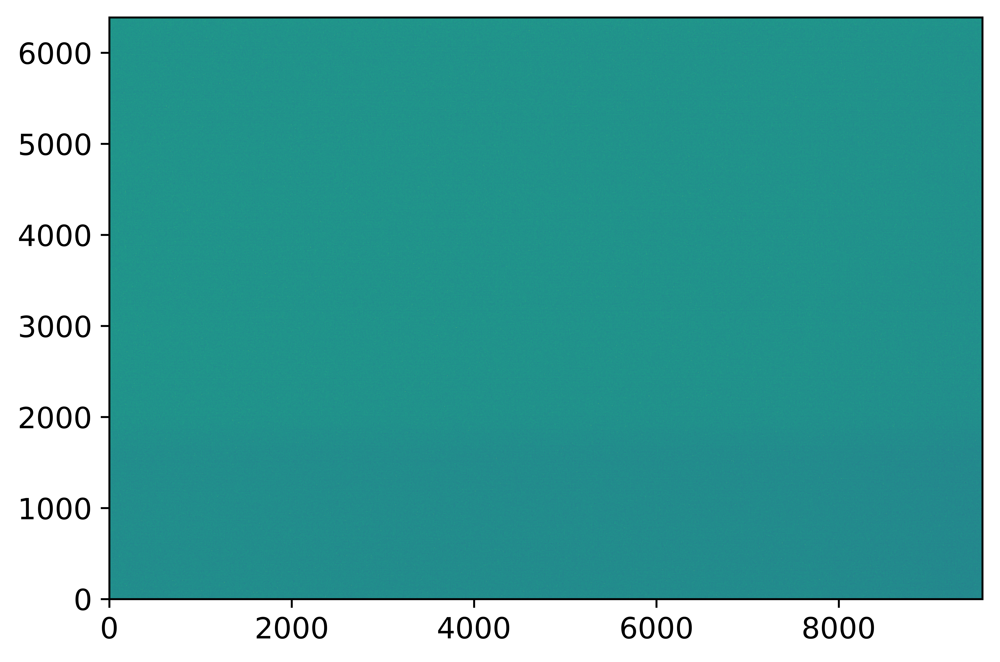

In [52]:
data = fits.getdata(biases[0])

interval = ZScaleInterval()
vmin, vmax = interval.get_limits(data)
plt.figure(dpi=1000)
plt.imshow(data, vmin=vmin, vmax=vmax, origin="lower")

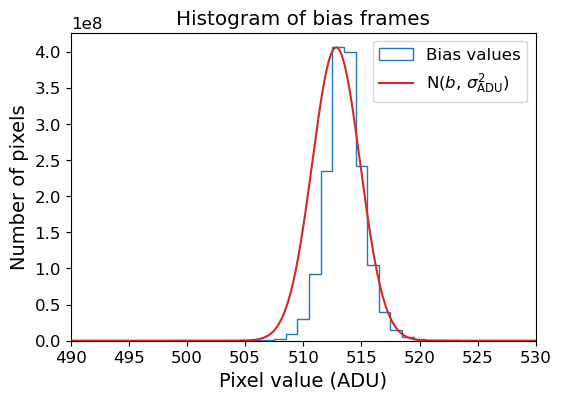

In [53]:
# get readout noise from bias frames
bias_imgs = np.array([fits.getdata(path) for path in biases])

# bring gain
gain = fits.getheader(biases[0])["EGAIN"]  # e-/ADU

# calculate the readout noise
bias_level = np.mean(bias_imgs.ravel())
sig_adu = np.std(bias_imgs, ddof=1)  # ADU
rdnoise = sig_adu * gain  # e-

# plot the bias histogram
fig = plt.figure(figsize=(6, 4))
ax = fig.add_subplot(111)
bins = np.arange(490, 530, 1)
y, _, _ = ax.hist(
    np.ravel(bias_imgs), bins=bins, histtype="step", align="left", label="Bias values"
)

# Gaussian model for comparison
x = np.linspace(490, 530, 1000)
gaussian = np.exp(-0.5 * ((x - bias_level) / sig_adu) ** 2) * np.max(y)
ax.plot(x, gaussian, c="tab:red", label=r"N($b$, $\sigma_{\rm ADU}^2$)")
ax.set_xlabel("Pixel value (ADU)")
ax.set_ylabel("Number of pixels")
ax.set_xlim(490, 530)
ax.set_title("Histogram of bias frames")
ax.legend()

In [58]:
bias_level

512.83057

In [60]:
np.median(bias_imgs.ravel())

514.0

In [56]:
rdnoise

0.5280146516395229

In [63]:
[fits.getheader(biases[i])["EGAIN"] for i in range(len(biases))]

[0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.2561904788017273,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.2561904788017273,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.2561904788017273,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.2561904788017273,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727,
 0.256190478801727]

## Double Population of 7DT01 Biases

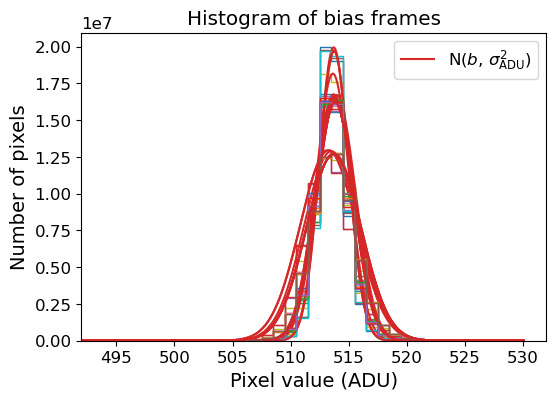

In [67]:
gain = fits.getheader(biases[0])["EGAIN"]  # e-/ADU

# plot the bias histogram
fig = plt.figure(figsize=(6, 4))
ax = fig.add_subplot(111)

for i in range(len(biases)):
    bias_imgs = np.array([fits.getdata(path) for path in biases[i : i + 1]])

    bias_level = np.mean(bias_imgs.ravel())
    sig_adu = np.std(bias_imgs, ddof=1)  # ADU
    rdnoise = sig_adu * gain  # e-

    bins = np.arange(490, 530, 1)
    y, _, _ = ax.hist(
        np.ravel(bias_imgs), bins=bins, histtype="step", align="left"
    )  # ,
    # label=f'{i}th bias values')

    x = np.linspace(490, 530, 1000)
    gaussian = np.exp(-0.5 * ((x - bias_level) / sig_adu) ** 2) * np.max(y)
    if i == 0:
        ax.plot(x, gaussian, c="tab:red", label=r"N($b$, $\sigma_{\rm ADU}^2$)")
        continue
    ax.plot(x, gaussian, c="tab:red")

ax.set_xlabel("Pixel value (ADU)")
ax.set_ylabel("Number of pixels")
ax.set_xlim(512 - 20, 512 + 20)
ax.set_title("Histogram of bias frames")
ax.legend()

In [69]:
heights = []
for i in range(len(biases)):
    bias_imgs = np.array([fits.getdata(path) for path in biases[i : i + 1]])
    y, _, _ = ax.hist(np.ravel(bias_imgs), bins=bins)
    heights.append(np.max(y))
heights

[19956485.0,
 16171442.0,
 16717362.0,
 12677028.0,
 12943353.0,
 19750760.0,
 16354343.0,
 16381467.0,
 12893733.0,
 12737764.0,
 16764469.0,
 16495940.0,
 16453450.0,
 12955190.0,
 16633170.0,
 16277549.0,
 12682013.0,
 16373468.0,
 18170658.0,
 19687125.0,
 16290041.0,
 12741383.0,
 16353107.0,
 16526268.0,
 16223136.0,
 12698589.0]

In [80]:
[int(fits.getheader(bias)["date-loc"][5:7]) for bias in biases]

[4, 5, 5, 3, 7, 4, 4, 5, 5, 3, 4, 4, 5, 7, 4, 5, 3, 5, 5, 5, 5, 3, 5, 4, 5, 3]

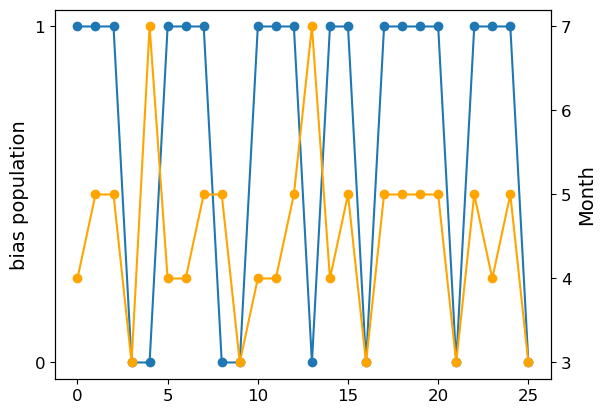

In [98]:
plt.plot((np.array(heights) > 1.4e7).astype("int"), "o-")  # two populations
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))
ax2 = plt.gca().twinx()
ax2.plot(
    [int(fits.getheader(bias)["date-loc"][5:7]) for bias in biases],
    "o-",
    color="orange",
)  # months each bias was taken
ax2.set_ylabel("Month")
ax2.set_yticks(range(3, 8))

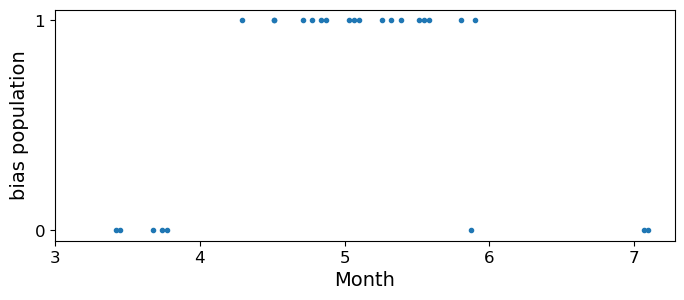

In [113]:
plt.figure(figsize=(8, 3))
months = [int(fits.getheader(bias)["date-loc"][5:7]) for bias in biases]
days = [int(fits.getheader(bias)["date-loc"][8:10]) for bias in biases]
plt.plot(
    np.array(months) + np.array(days) / 31,
    (np.array(heights) > 1.4e7).astype("int"),
    ".",
)  # two populations
plt.xlabel("Month")
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))
plt.gca().set_xticks(range(3, 8))

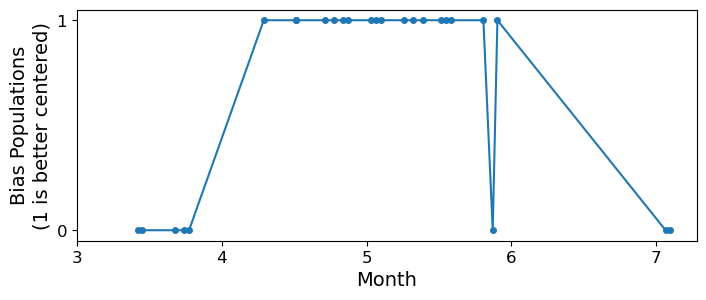

In [125]:
plt.figure(figsize=(8, 3))
months = np.array([int(fits.getheader(bias)["date-loc"][5:7]) for bias in biases])
days = np.array([int(fits.getheader(bias)["date-loc"][8:10]) for bias in biases])
times = months + days / 31
sorted_indices = np.argsort(times)
plt.plot(
    times[sorted_indices],
    (np.array(heights) > 1.4e7).astype("int")[sorted_indices],
    ".-",
    ms=8,
)  # two populations
plt.xlabel("Month")
plt.ylabel("Bias Populations\n(1 is better centered)")
plt.gca().set_yticks(range(0, 2))
plt.gca().set_xticks(range(3, 8))
plt.show()

Text(0, 0.5, 'CCDTEMP')

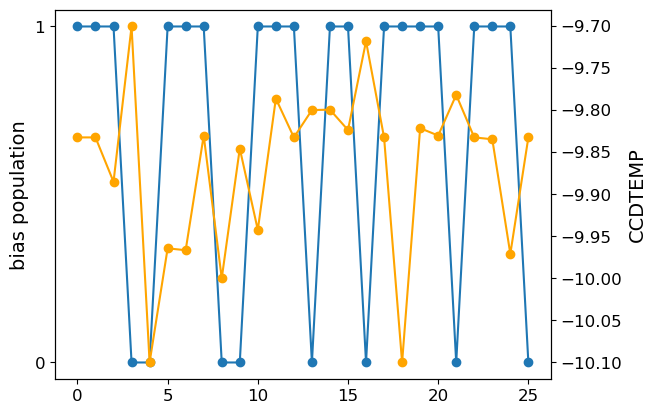

In [99]:
plt.plot(
    (np.array(heights) > 1.4e7).astype("int"), "o-", label="bias population"
)  # two populations
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))
ax2 = plt.gca().twinx()
ax2.plot(
    [float(fits.getheader(bias)["ccd-temp"]) for bias in biases], "o-", color="orange"
)  # months each bias was taken
ax2.set_ylabel("CCDTEMP")

In [94]:
fits.getheader(biases[7])["CENTALT"]

56.7090687588558

"Keyword 'CENTALT' not found."


Text(0, 0.5, 'CENTALT')

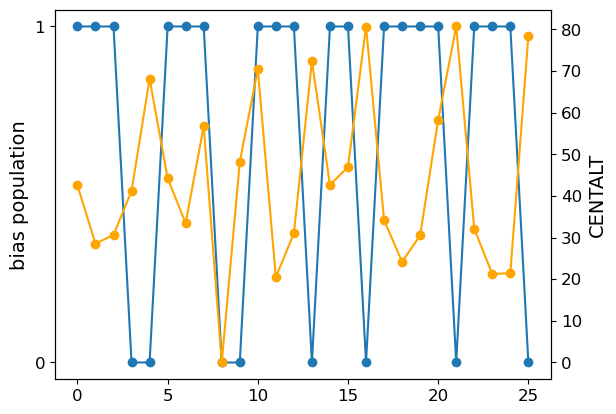

In [100]:
plt.plot(
    (np.array(heights) > 1.4e7).astype("int"), "o-", label="bias population"
)  # two populations
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))

ax2 = plt.gca().twinx()
alts = []
for bias in biases:
    try:
        alt = float(fits.getheader(bias)["CENTALT"])
    except Exception as e:
        print(e)
        alt = 0
    alts.append(alt)

ax2.plot(alts, "o-", color="orange")  # months each bias was taken
ax2.set_ylabel("CENTALT")

float() argument must be a string or a real number, not 'NoneType'


Text(0, 0.5, 'HUMIDITY')

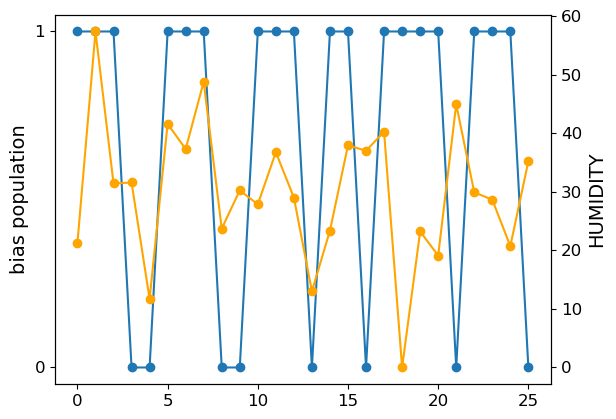

In [102]:
plt.plot(
    (np.array(heights) > 1.4e7).astype("int"), "o-", label="bias population"
)  # two populations
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))

arg = "HUMIDITY"
ax2 = plt.gca().twinx()
alts = []
for bias in biases:
    try:
        alt = float(fits.getheader(bias)[arg])
    except Exception as e:
        print(e)
        alt = 0
    alts.append(alt)

ax2.plot(alts, "o-", color="orange")  # months each bias was taken
ax2.set_ylabel(arg)

float() argument must be a string or a real number, not 'NoneType'


Text(0, 0.5, 'DEWPOINT')

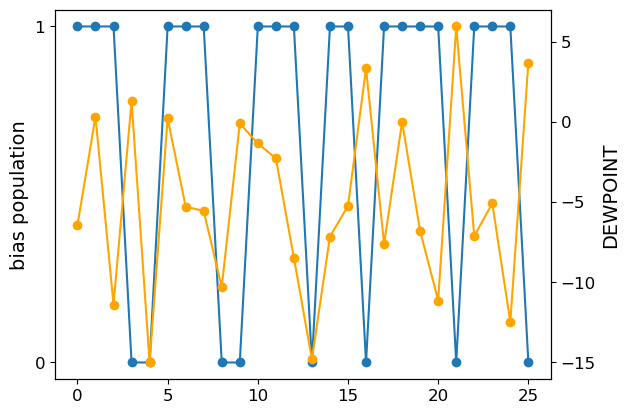

In [103]:
plt.plot(
    (np.array(heights) > 1.4e7).astype("int"), "o-", label="bias population"
)  # two populations
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))

arg = "dewpoint".upper()
ax2 = plt.gca().twinx()
alts = []
for bias in biases:
    try:
        alt = float(fits.getheader(bias)[arg])
    except Exception as e:
        print(e)
        alt = 0
    alts.append(alt)

ax2.plot(alts, "o-", color="orange")  # months each bias was taken
ax2.set_ylabel(arg)

float() argument must be a string or a real number, not 'NoneType'


Text(0, 0.5, 'AMBTEMP')

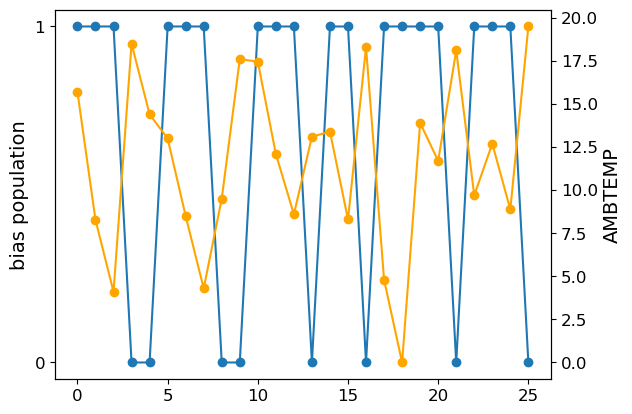

In [104]:
plt.plot(
    (np.array(heights) > 1.4e7).astype("int"), "o-", label="bias population"
)  # two populations
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))

arg = "ambtemp".upper()
ax2 = plt.gca().twinx()
alts = []
for bias in biases:
    try:
        alt = float(fits.getheader(bias)[arg])
    except Exception as e:
        print(e)
        alt = 0
    alts.append(alt)

ax2.plot(alts, "o-", color="orange")  # months each bias was taken
ax2.set_ylabel(arg)

float() argument must be a string or a real number, not 'NoneType'


Text(0, 0.5, 'PRESSURE')

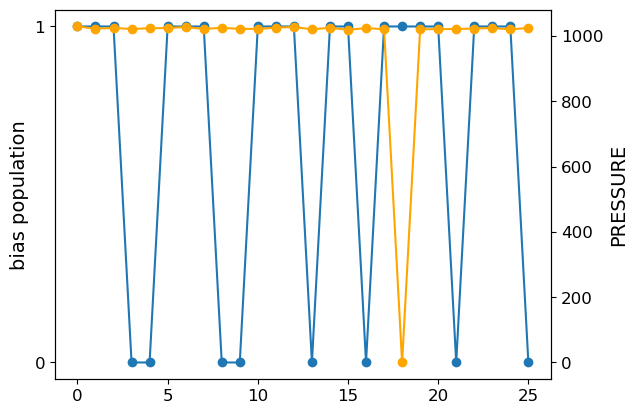

In [105]:
plt.plot(
    (np.array(heights) > 1.4e7).astype("int"), "o-", label="bias population"
)  # two populations
plt.ylabel("bias population")
plt.gca().set_yticks(range(0, 2))

arg = "pressure".upper()
ax2 = plt.gca().twinx()
alts = []
for bias in biases:
    try:
        alt = float(fits.getheader(bias)[arg])
    except Exception as e:
        print(e)
        alt = 0
    alts.append(alt)

ax2.plot(alts, "o-", color="orange")  # months each bias was taken
ax2.set_ylabel(arg)

In [23]:
hdul = fits.open(datadir / "m400/calib_7DT01_T10600_20240424_233715_m400_120.fits")
hdul.info()

Filename: /Users/dhhyun/VSCode/Lyman/7DT01/m400/calib_7DT01_T10600_20240424_233715_m400_120.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     167   (9576, 6388)   float32   


In [25]:
hdul[0].header

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -32 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 9576                                                  
NAXIS2  =                 6388                                                  
EXTEND  =                    T                                                  
ORIGIN  = 'Eclair v0.9 25 October 2019' / FITS file originator                  
DATE    = '2024-04-29T03:27:50.630' / Date HDU was created                      
IMAGETYP= 'LIGHT'              / Type of exposure                               
EXPOSURE=                120.0 / [s] Exposure duration                          
EXPTIME =                120.0 / [s] Exposure duration                          
DATE-LOC= '2024-04-24T19:37:15.933' / Time of observation (local)               
DATE-OBS= '2024-04-24T23:37:

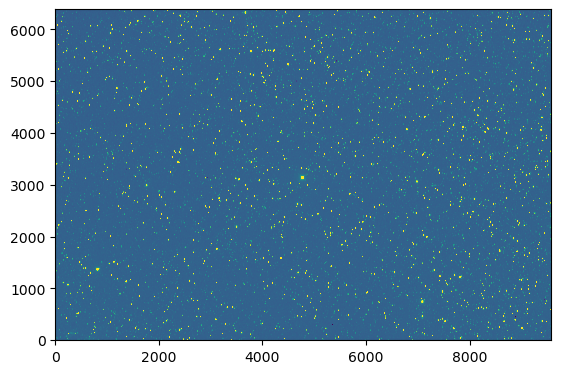

In [28]:
interval = ZScaleInterval()
data = hdul[0].data
vmin, vmax = interval.get_limits(data)
plt.imshow(data, vmin=vmin, vmax=vmax, origin="lower")

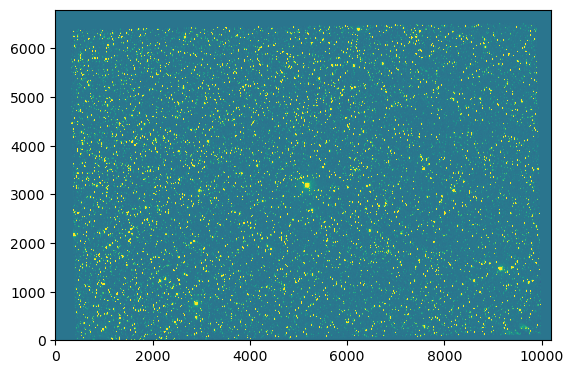

In [33]:
data = fits.getdata(scilist[-5])

interval = ZScaleInterval()
vmin, vmax = interval.get_limits(data)
plt.imshow(data, vmin=vmin, vmax=vmax, origin="lower")

# GW240422ed ToO Reduction Practice

# Photometry with SExtractor